___
# __**Predicting NYC taxi trip durations for yellow taxi rides in 2016**__
___
## Table of contents: <a name="0"></a>

## [1. Introduction](#1)
## [2. NYC trips Data](#2)
### $\quad$ [2.1. Extracting the data from city of New York's website](#2.1)
### $\quad$ [2.2. Adding new features](#2.2)
### $\quad$ [2.3. EDA](#2.3)

## [3. Adding NYC taxi zones data (shapefile)](#3)
### $\quad$ [3.1. Mapping the pickup and dropoff lat lon locations onto the taxi zones](#3.1)
### $\quad$ [3.2. More EDA](#3.2)

## [4. Adding trip direction](#4)

## [5. Clustering the similar zones](#5)

## [6. Future Work](#6)

___


# 1. Introduction <a name="1"></a> [(toc)](#0)
______
This project is inspired by the [NYC taxi trip duration challenge](https://www.kaggle.com/c/nyc-taxi-trip-duration/overview) hosted on Kaggle. But instead of using the train and test data from Kaggle, taxi data will be queried directly from the city of NY's website. Only Yellow taxi trips will be considered for this project. More information about different taxi options available in NYC can be found [here](https://www1.nyc.gov/site/tlc/vehicles/get-a-vehicle-license.page).

The motive of this project is to identify the main factors influencing the daily taxi trips of New Yorkers. The taxi trips data is taken from the NYC Taxi and Limousine Commission (TLC), and it includes pickup time, pickup and dropoff geo-coordinates, number of passengers, and several other variables. The taxi trips considered in this project are only for the year 2016 and only those trips will be considered whose exact pickup and dropoff geo-coordinates are available. 

Policy researchers at the TLC and NYC can use the project observations and ML models to observe changing trends in the industry and maked informed decisions regarding transporation planning within the city.

In [1]:
# Check if you are using the right conda environment
import os
print (os.environ['CONDA_DEFAULT_ENV'])

nyc_trip


In [2]:
# importing all the required libraries and modules

## The number crunching libraries
import pandas as pd
import numpy as np
import random
import geopandas
from shapely.geometry import Point

## The plotters.....
import matplotlib.pyplot as plt
import seaborn as sns
import bokeh
plt.style.use('bmh')
plt.rcParams['figure.figsize'] = [10, 5]

## The ones keeping track of the time
from datetime import datetime, timedelta
from pandas.tseries.holiday import USFederalHolidayCalendar as calendar
import time
import matplotlib.dates as mdates

## For getting data over the internet and then processing it
import io
import requests
import pathlib
import scipy.stats
import json
from bs4 import BeautifulSoup
from lxml import html

# 2. NYC trips Data <a name="2"></a>  [(toc)](#0)

## 2.1 Extracting the data from city of New York's website <a name="2.1"></a> [(toc)](#0)
Also added a functionality that if data already exists in the directory then it shouldn't be downloaded again.

In [3]:
# Importing data preparation modules
# NYC is the directory location of the module wherein all the user defined functions for data importing and preparation are defined

import sys
sys.path.append('../NYC')

#%load_ext autoreload (if you need to edit the module while working on this notebook)
import data_prep, data_multithreading
from data_fetch_n_save import NycUrlInfo, FetchNYCRaw
#import importlib
#importlib.reload(data_fetch_n_save)

___
Below is the url API to access the data from city of new york's website; the data can be filtered using SQL queries. More information on how to extract the data from city of new york's site can be found [here](https://dev.socrata.com/foundry/data.cityofnewyork.us/uacg-pexx)

The total number of yellow taxi rides for the year of 2016 was around 131M but for the sake of working on a local machine let's extract only a fraction of the data. 

`Limit` is the number of rows that will be extracted randomly from each month.
Let's extract 700,000 trip records from each month from January to June of 2016 i.e. we will extract only 4.2M rides out of the total 131M. And extracting the first 6 months only because 
only the first 6 months have the exact pickup and dropoff lat lon locations.   

_Note_ : We can even pass range(1, 12) to the _months_ variable below, because our query anyways will filter out the data where pickup_longitude and pickup_latitude is not NULL but filtering all 12 months will take more time so using the prior knowledge here to save some time.

First checking if the file already exists in our directory path. If it already exists (i.e. if you had already downloaded it before), then the dataframe will load the .csv or .parquet file instead of fetching it again from the url. If you want to fetch the data anyways or fetch a new batch of data, use `fetch_if_exists = True`.

In [4]:
nyc_sql_file_loc = '../data/raw/nyc_2016_raw_sql.parquet'

raw_url = "https://data.cityofnewyork.us/resource/uacg-pexx.csv?" # .json # their json file, for some reason, doesn't give correct lat/lon locations (many 0s)
query = "$query= SELECT * WHERE pickup_longitude IS NOT NULL AND pickup_latitude IS NOT NULL" 
months = [1, 2, 3, 4, 5, 6]
limit = 700_000

nyc_url_info = NycUrlInfo(raw_url, query, months, limit)
nyc_sql = FetchNYCRaw(nyc_url_info).fetch_data_from_url(nyc_sql_file_loc, fetch_if_exists = False)

# 100 rows -> 0.32s; 4.2M rows -> 60s; 99.3 MB parquet file # without multithreading it takes more than 3 to 4 minutes

Loading the pre-existing file ../data/raw/nyc_2016_raw_sql.parquet
time to run function fetch_data_from_url: 0.33928 seconds


In [5]:
nyc_sql.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4200000 entries, 0 to 4199999
Data columns (total 10 columns):
 #   Column              Dtype         
---  ------              -----         
 0   vendorid            int64         
 1   pickup_datetime     datetime64[ns]
 2   dropoff_datetime    datetime64[ns]
 3   passenger_count     int64         
 4   trip_distance       float64       
 5   pickup_longitude    float64       
 6   pickup_latitude     float64       
 7   store_and_fwd_flag  object        
 8   dropoff_longitude   float64       
 9   dropoff_latitude    float64       
dtypes: datetime64[ns](2), float64(5), int64(2), object(1)
memory usage: 320.4+ MB


In [6]:
# Checking the range of the data
nyc_sql['pickup_datetime'].min(), nyc_sql['pickup_datetime'].max() 

(Timestamp('2016-01-01 00:00:08'), Timestamp('2016-06-30 23:59:58'))

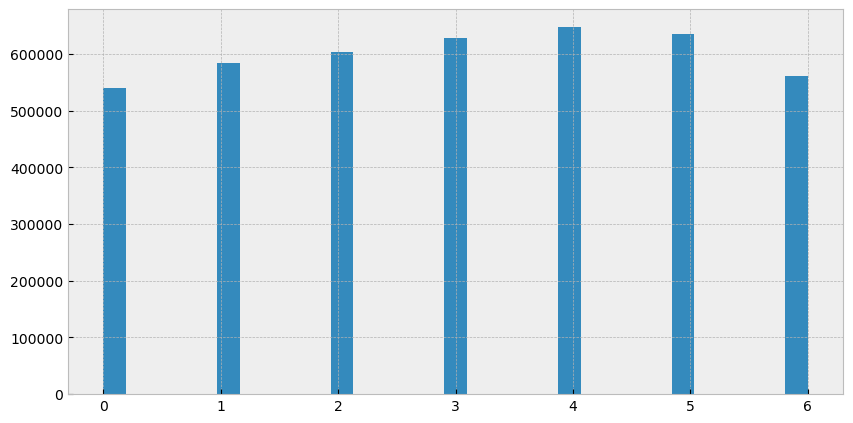

In [7]:
# Checking if _limit_ number of rides were extracted randomly and equally across all days for each month
_ = plt.hist(nyc_sql['pickup_datetime'].dt.weekday, bins = 31)

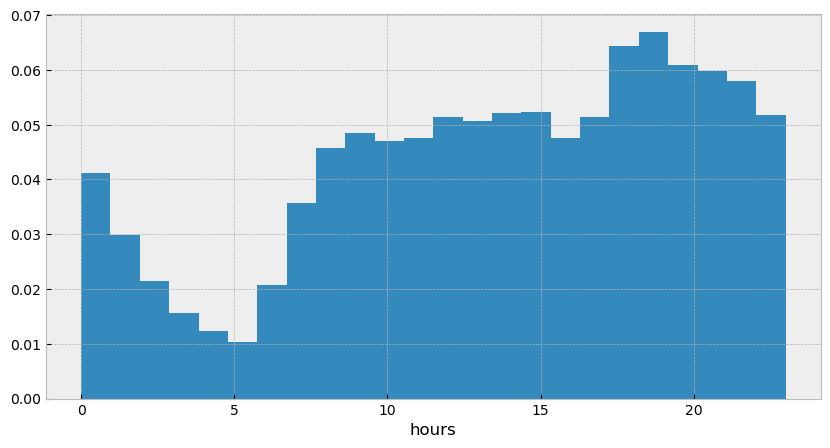

In [8]:
# Checking if _limit_ number of rides were extracted randomly and equally across all hours. 
#... We can expect a dip in the night and early morning hours because the number of rides are anyways lower during that time
_ = plt.hist(nyc_sql['dropoff_datetime'].dt.hour, bins = 24, density = True)
_ = plt.xlabel('hours')

In [9]:
# Checking if any of the values in any of the rows or the columns is null
nyc_sql.isnull().sum()

vendorid              0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
trip_distance         0
pickup_longitude      0
pickup_latitude       0
store_and_fwd_flag    0
dropoff_longitude     0
dropoff_latitude      0
dtype: int64

___
Luckily we don't have any null values except the locationid columns which are just the zone ids, and we are going to remove them for now because we have the exact pickup and dropoff locations. The first 6 months of the data on the city of new york's website has only the pickup and dropoff coordinates and the next 6 months only have the locationid values. 

In [10]:
# WE are going to remove the 'trip_distance' column because it is strongly associated with our dependent variable trip_duration
# and using that for prediction will mean allowing data leakage. And we won't have the trip_distance data for a fresh test
# set anyways.
# But checking the stats on the variable before removing it

percentile_trip_distance = [1, 25, 50, 75, 95, 99, 99.8]
print("Total number of trips = {:,}".format(len(nyc_sql)))
for i in percentile_trip_distance:
    print("{}% of the trips were below {:.2f} miles".format(i, np.percentile(nyc_sql.trip_distance, i)))

Total number of trips = 4,200,000
1% of the trips were below 0.20 miles
25% of the trips were below 1.00 miles
50% of the trips were below 1.70 miles
75% of the trips were below 3.17 miles
95% of the trips were below 10.52 miles
99% of the trips were below 18.64 miles
99.8% of the trips were below 22.00 miles


In [11]:
nyc_sql.describe().T

,count,mean,std,min,25%,50%,75%,max
vendorid,4200000.0,1.530885,0.499045,1.000000,1.000000,2.000000,2.000000,2.000000e+00
passenger_count,4200000.0,1.661382,1.310746,0.000000,1.000000,1.000000,2.000000,9.000000e+00
trip_distance,4200000.0,3.617976,900.903686,0.000000,1.000000,1.700000,3.170000,1.674368e+06
pickup_longitude,4200000.0,-72.922471,8.755552,-131.818970,-73.991707,-73.981468,-73.966301,3.889659e+01
pickup_latitude,4200000.0,40.171835,4.823396,-77.039490,40.736214,40.753456,40.768162,5.124434e+01
dropoff_longitude,4200000.0,-72.986805,8.486672,-121.933411,-73.991211,-73.979469,-73.962021,3.889659e+01
dropoff_latitude,4200000.0,40.208198,4.675412,-77.039490,40.734604,40.753963,40.769558,4.918594e+01


#### Next we will add some features to the dataset and at the same time also remove the outliers, which i have defined as below:
* _trip_duration_ < 60 seconds OR trip_duration > 99.8th percentile value of the trip duration
* The _pickup_ and _dropoff_ _latitudes_ and _longitudes_ should be within the NYC boundary defined as   
  nyc_long_limits = (-74.257159, -73.699215), nyc_lat_limits = (40.471021, 40.987326))
* _haversine_distance_ (check _..NYC/data_prep.py)_ between the pickup and dropoff points is > _0_ and < its 99.8th percentile      value.
* We will also add new features and remove outliers after some EDA based on our observations.

## 2.2 Adding new features <a name="2.2"></a> [(toc)](#0)

In [12]:
from data_fetch_n_save import AddFeatWrangle

In [13]:
nyc_raw_file_loc = '../data/interim/1_nyc_raw_cony.parquet'

nyc_raw = AddFeatWrangle(nyc_sql).fetch_prepared_data(nyc_raw_file_loc, fetch_if_exists = False)

# time to clean and wrangle the dataset: 5 seconds # reduced the speed by 10 times..
# ..by vectorizing the haversine and bearing functions using numpy

Loading the pre-existing file ../data/interim/1_nyc_raw_cony.parquet
time to run function fetch_prepared_data: 0.34982 seconds


In [14]:
print("Fraction of data omitted by cleaning = {:.2f} %, dataset reduced from {:,} to {:,}\
        ".format(100*1- 100*len(nyc_raw)/len(nyc_sql), len(nyc_sql), len(nyc_raw)))

Fraction of data omitted by cleaning = 2.70 %, dataset reduced from 4,200,000 to 4,086,552        


In [15]:
try: 
    del nyc_sql #deleting previous dataframe to clear some space
except NameError as e: 
    print(f"{e.name} doesn't exist. If this cell was already run before, the variable may have already been deleted \n")
    
nyc_raw.head(3)

,vendorid,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,trip_duration,pickup_date,pickup_month,pickup_day,pickup_hour,pickup_weekday,holiday,distance_hav,bearing
0,2,2016-01-06 19:48:59,2016-01-06 19:52:17,4,-73.954727,40.777859,N,-73.954231,40.784752,198.0,2016-01-06,1,6,19,Wednesday,0,0.477112,3.117967
1,2,2016-01-27 08:33:47,2016-01-27 09:22:31,1,-73.863220,40.769947,N,-74.004044,40.716190,2924.0,2016-01-27,1,27,8,Wednesday,0,8.256996,243.305164
2,2,2016-01-29 14:43:01,2016-01-29 14:57:18,6,-73.979187,40.781979,N,-73.961311,40.811150,857.0,2016-01-29,1,29,14,Friday,0,2.222464,24.880864


In [16]:
nyc_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4086552 entries, 0 to 4086551
Data columns (total 18 columns):
 #   Column              Dtype         
---  ------              -----         
 0   vendorid            int64         
 1   pickup_datetime     datetime64[ns]
 2   dropoff_datetime    datetime64[ns]
 3   passenger_count     int64         
 4   pickup_longitude    float64       
 5   pickup_latitude     float64       
 6   store_and_fwd_flag  object        
 7   dropoff_longitude   float64       
 8   dropoff_latitude    float64       
 9   trip_duration       float64       
 10  pickup_date         datetime64[ns]
 11  pickup_month        int64         
 12  pickup_day          int64         
 13  pickup_hour         int64         
 14  pickup_weekday      category      
 15  holiday             int64         
 16  distance_hav        float64       
 17  bearing             float64       
dtypes: category(1), datetime64[ns](3), float64(7), int64(6), object(1)
memory usage: 5

#### Checking the target variable

In [17]:
percentile_trip_duration = [1, 25, 50, 75, 95, 99, 99.8]
print("Total number of trips = {:,}".format(len(nyc_raw)))
for i in percentile_trip_duration:
    print("{}% of the trips were below {:.2f} minutes".format(i, np.percentile(nyc_raw.trip_duration/60, i)))

Total number of trips = 4,086,552
1% of the trips were below 1.83 minutes
25% of the trips were below 6.68 minutes
50% of the trips were below 11.08 minutes
75% of the trips were below 17.95 minutes
95% of the trips were below 34.72 minutes
99% of the trips were below 54.62 minutes
99.8% of the trips were below 73.48 minutes


#### Checking if the distribution of the approximate haversine distance is similar to the original trip_distance variable which we have removed from the data.

In [18]:
percentile_trip_distance = [1, 25, 50, 75, 95, 99, 99.8]
print("Total number of trips = {:,}".format(len(nyc_raw)))
for i in percentile_trip_distance:
    print("{}% of the trips were below {:.2f} miles".format(i, np.percentile(nyc_raw.distance_hav, i)))

Total number of trips = 4,086,552
1% of the trips were below 0.21 miles
25% of the trips were below 0.78 miles
50% of the trips were below 1.31 miles
75% of the trips were below 2.42 miles
95% of the trips were below 6.80 miles
99% of the trips were below 12.88 miles
99.8% of the trips were below 14.06 miles


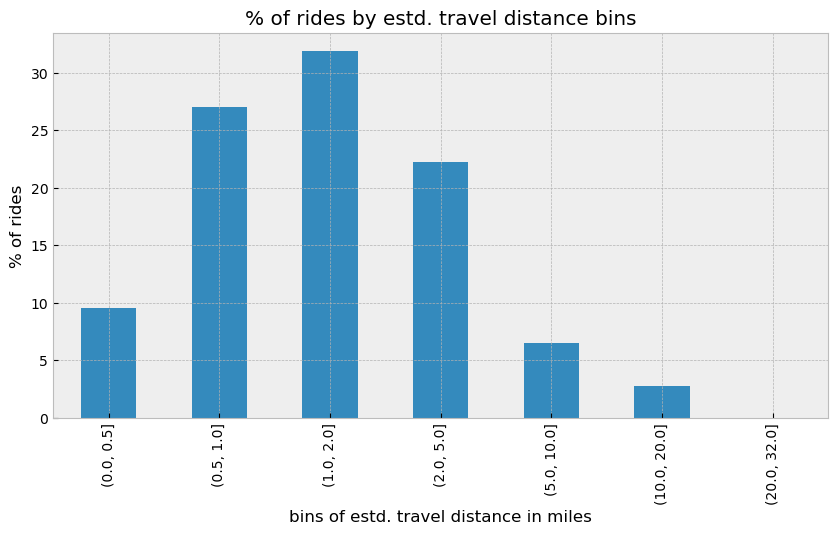

In [19]:
_ = (100*(nyc_raw.distance_hav).value_counts(bins = [0.001, 0.5, 1, 2, 5, 10, 20, np.ceil(nyc_raw.distance_hav.max())], 
                                               sort=False)/nyc_raw.shape[0]).plot(kind = 'bar',  xlabel = 'bins of estd. travel distance in miles',
                                                                             ylabel = '% of rides', title = '% of rides by estd. travel distance bins')

* The calculated haversine distance values are a bit lower than the actual trip distance values, this is because the haversine distance calculates the distance along the curvature of the earth on a straight path which will be always shorter than the actual path. But it's a good approximation nevertheless as we cannot use the actual trip distance values.
* But a useful observation can be seen here that 75% of the trips are below 3 miles, so most of the trips were short distance trips within neighboring taxi zones. This is true for the yellow taxi rides within NYC, especially the ones within the busy areas of Manhattan.

### Adding average taxi ride speed (distance/time) and adding separate columns for discrete bins of speed and time_duration data.

#### Speed in miles/hour = distance_in_miles/trip_duration_in_hours

In [20]:
nyc_raw['speed_mph'] = nyc_raw.distance_hav/(nyc_raw.trip_duration/60/60)
nyc_raw['trip_duration_minutes'] = nyc_raw.trip_duration/60

#### Defining the bins for _trip_duration_

In [21]:
cut_labels = ['(0-5]', '(5-10]', '(10-20]', '(20-40]', 
              '(40-60]', '(60-'+str(np.ceil((nyc_raw['trip_duration']/60).max()/10)*10)+']']
cut_bins = [0, 5, 10, 20, 40, 60, np.ceil((nyc_raw['trip_duration']/60).max()/10)*10]
nyc_raw['trip_bins_minutes'] = pd.cut((nyc_raw['trip_duration']/60), bins = cut_bins, labels = cut_labels)

#### Checking stats on the average speed variable

In [22]:
percentile_speed = [1, 25, 50, 75, 95, 99, 99.8]
print("Total number of trips = {:,}".format(len(nyc_raw)))
for i in percentile_speed:
    print("{}% of the trips were below {:.2f} mph".format(i, np.percentile(nyc_raw.speed_mph, i)))

Total number of trips = 4,086,552
1% of the trips were below 1.87 mph
25% of the trips were below 5.73 mph
50% of the trips were below 7.98 mph
75% of the trips were below 11.10 mph
95% of the trips were below 18.19 mph
99% of the trips were below 25.01 mph
99.8% of the trips were below 30.46 mph


* The lower average speed values seem appropriate for a busy city like NYC.
* We need to check the speeds above the 99.8% value and see if those trips were really that fast or they are indeed outliers.

In [23]:
nyc_raw.speed_mph.min(), nyc_raw.speed_mph.max()

(0.0008203286073039362, 501.8735613737581)

501.87 is definitely an outlier unless a Boeing has registered as a NYC yellow cab.

In [24]:
nyc_raw.distance_hav.min(), nyc_raw.distance_hav.max()

(0.0002636444991341056, 31.882634018537004)

## 2.3 Initial EDA <a name="2.3"></a> [(toc)](#0)

In [25]:
import bokeh, bokeh.plotting, bokeh.models
from bokeh.io import output_notebook, show
output_notebook()

import geopandas as gpd
from shapely.geometry import Point
import urllib

import sklearn.preprocessing

Loading BokehJS ...

In [26]:
# Importing EDA modules
import plot_figs
#importlib.reload(plot_figs)

#### Histogram of trip duration (minutes)

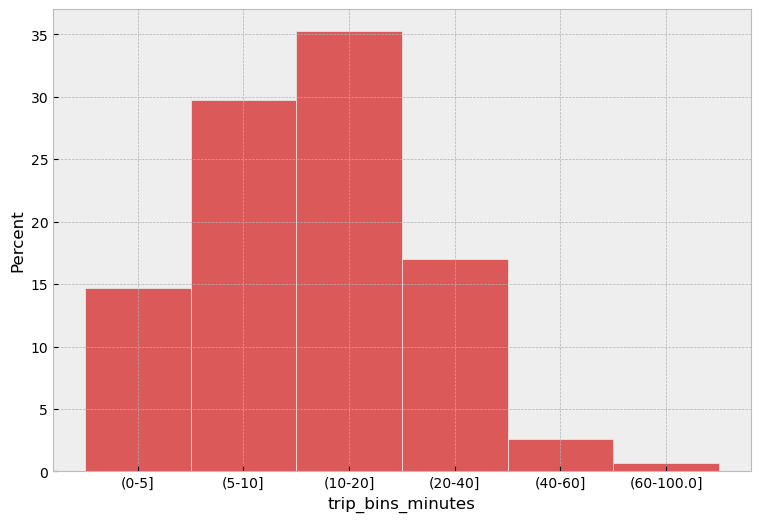

In [27]:
# Similar plot that we had plotted earlier, but with seaborn. If you like colors, you can use this one instead. 
_ = plt.figure(figsize = (9, 6)) 
_ = sns.histplot(x = 'trip_bins_minutes', data = nyc_raw, stat = 'percent', color = 'tab:red')

#### Plotting the rides on a scatter plot. 

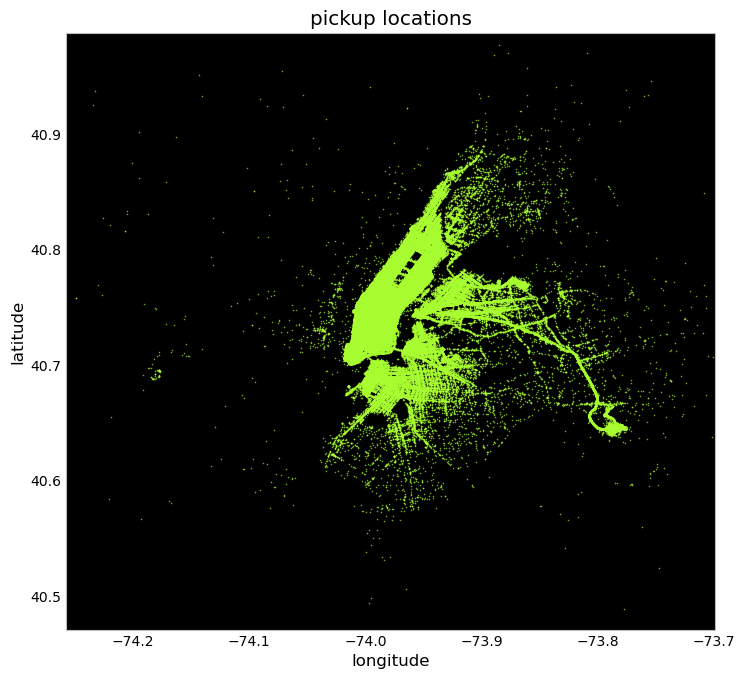

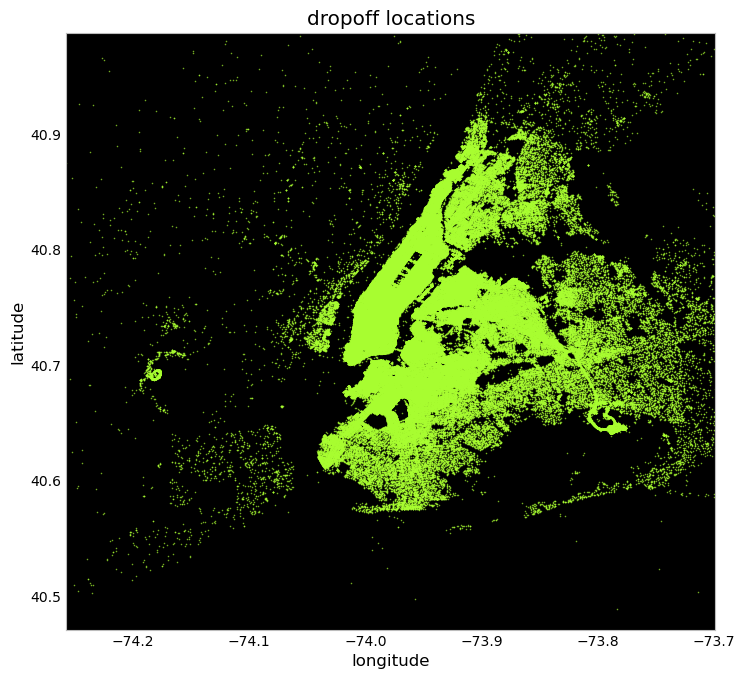

In [28]:
fig_size = (15, 15)
plot_figs.plot_points(df = nyc_raw, colA = 'pickup_longitude', colB = 'pickup_latitude', figsize = fig_size)
plot_figs.plot_points(df = nyc_raw, colA = 'dropoff_longitude', colB = 'dropoff_latitude', figsize = fig_size)

* The scattered points give out the overall layout of the NYC boroughs and we can see that the density is highest in the Manhattan area, especially for the pickups. The dropoff locations are more spread out.
* Pickups and Dropoffs are denser in the John F. Kennedy International Airport area whereas only dropoffs are denser in the Newark Liberty International Airport area because the Newark airport is served majorly by the Newark taxis and not by NYC taxis.
* LaGuardia Airport also seems to be served well by the yellow taxis. 
* Also, since the yellow (medallion) taxis are able to pick up passengers only in the five boroughs of NYC, the pickup locations are mostly within NYC but the dropoffs can be outside the limits as seen from the plots. 

#### Let's plot the pickups density weighted by trip duration on google maps. [Ref link](https://buildmedia.readthedocs.org/media/pdf/jupyter-gmaps/latest/jupyter-gmaps.pdf)

'apikey.txt' file not found. Please upload a file named apikey.txt which contains your Google API key


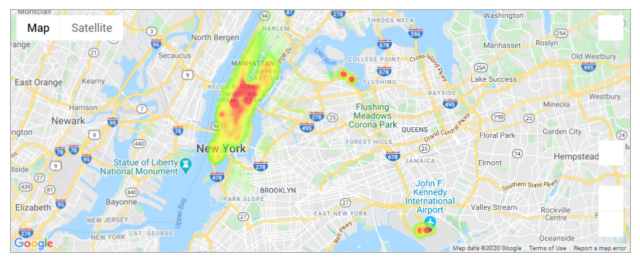

In [29]:
#import gmaps
new_york_coordinates = (nyc_raw.pickup_latitude.median(), nyc_raw.pickup_longitude.median())
# Using google maps api
#....more information)
# Reading in Google API key from text file "apikey"
fname = 'apikey.txt'

def read_file(fname):
    """ Given a filename, return the contents of that file
    """
    try:
        with open(fname, 'r') as f:
            # It's assumed our file contains a single line, with our API key only
            return f.read().strip()
    except FileNotFoundError:
        print("'%s' file not found. Please upload a file named apikey.txt which contains your Google API key" % fname)

api_key = read_file(fname)

#/___Run this code between the dotted lines to obtain the google maps image shown below of the clusters of rides 
#......weighted by the trip duration.__/
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
#gmaps.configure(api_key=api_key) # Fill in with your API key
#locations = nyc_raw[['pickup_latitude', 'pickup_longitude']]
##Get the magnitude from the data
#weights = nyc_raw['trip_duration']
##Set up your map
#fig = gmaps.figure(center = new_york_coordinates, zoom_level = 10)
#fig.add_layer(gmaps.heatmap_layer(locations, weights=weights))
#fig
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
nyc_density_map = plt.imread('../data/interim/images/NYC_map_pickups_trip_duration.png')
_ = plt.figure(figsize = (8,5))
_ = plt.imshow(nyc_density_map)
_ = plt.xticks([])
_ = plt.yticks([])

#### Checking number of trips by day

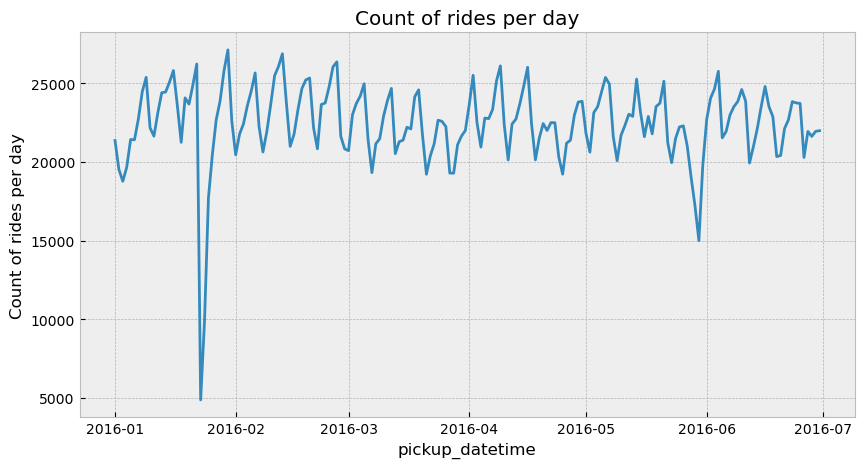

In [30]:
_ = nyc_raw.groupby(nyc_raw.pickup_datetime.dt.date).size().plot()
_ = plt.title('Count of rides per day')
_ = plt.ylabel('Count of rides per day')

* The number of rides per day is cyclical with a dip in the rides during the night time. 
* The sudden dip in the taxi rides between the 20th and 26th Jan was because of the heavy snow that was observed during that period.

#### Plotting average trip duration for each hour over the entire year and the average number of rides per hour

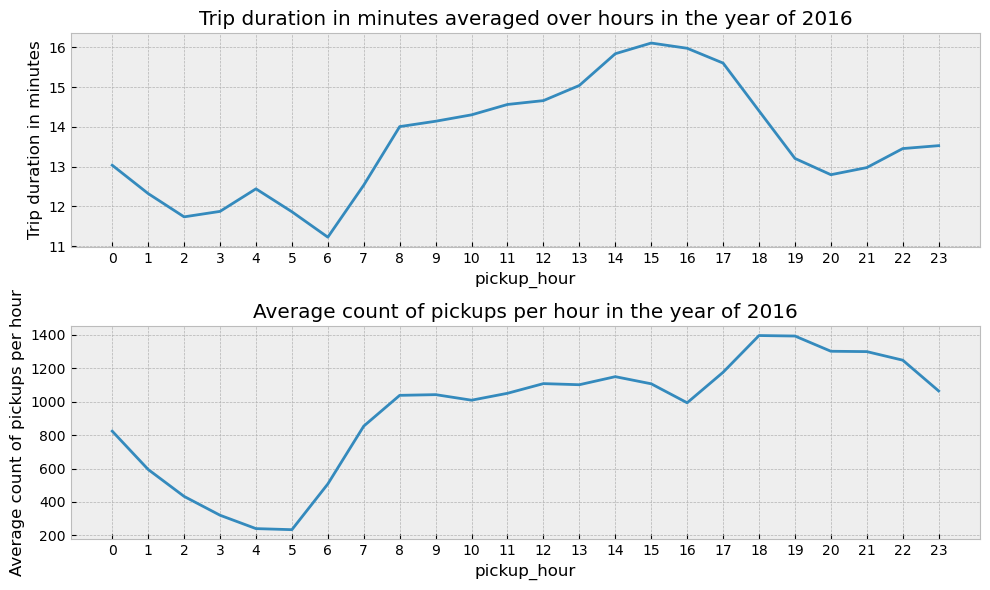

In [31]:
#Plotting average trip duration for each hour over the entire year
ax1 = plt.subplot(211)
_ = (nyc_raw.groupby(nyc_raw.pickup_hour)['trip_duration'].mean()/60).plot(ax = ax1, figsize=(10,6))
_ = plt.ylabel('Trip duration in minutes')
_ = plt.xticks(nyc_raw.pickup_hour.unique())
_ = plt.title('Trip duration in minutes averaged over hours in the year of 2016')

# Plotting the average number of rides per hour
ax2 = plt.subplot(212)
_ = nyc_raw.groupby(['pickup_date', 
                    'pickup_hour']).count()['vendorid'].groupby('pickup_hour').mean().plot(ax = ax2, figsize=(10,6))
_ = plt.ylabel('Average count of pickups per hour')
_ = plt.xticks(nyc_raw.pickup_hour.unique())
_ = plt.title('Average count of pickups per hour in the year of 2016')
_ = plt.tight_layout()

* Note: Please notice that the y-axis doesn't start at 0. 
* As one would expect the trip duration and the number of rides are higher in the evening time. As the number of rides go up in a certain area one can expect the resulting traffic to slow down the traffic increasing the trip duration time.
* From the 2nd plot we can see how the pickup rides increase steadily from 5am to 8am only to flatten out between 8am to 4pm and then again steeply increase from 4pm to 6pm to fall down later.
* The average trip duration is around 15 minutes during the evening time.

#### Plotting a heatmap with a colorbar; the colorbar shows the trip duration in seconds

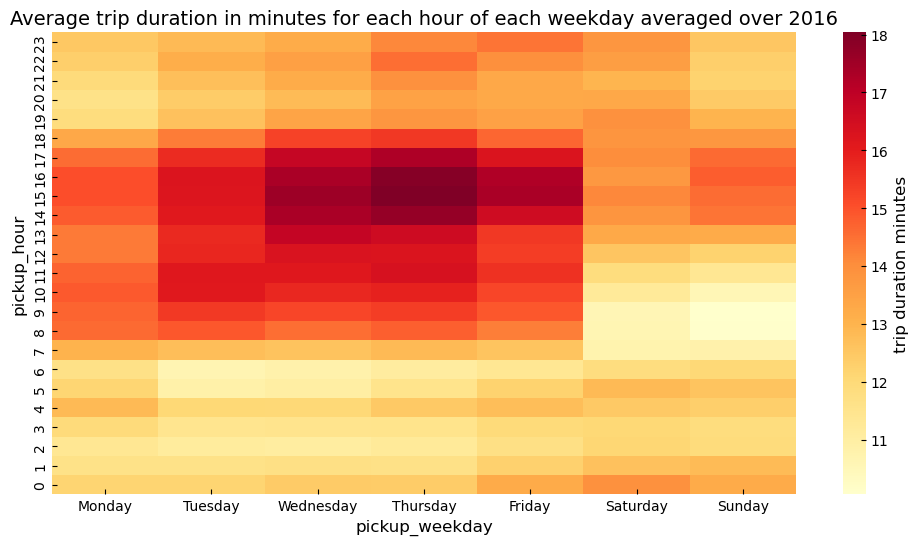

In [32]:
nyc_raw['pickup_weekday'] = pd.Categorical(nyc_raw['pickup_weekday'], 
                                           categories= ['Monday','Tuesday','Wednesday','Thursday',
                                                        'Friday','Saturday', 'Sunday'], ordered=True)
hour_weekday = nyc_raw.pivot_table(values = 'trip_duration_minutes', index = 'pickup_hour', 
                                   columns = 'pickup_weekday', aggfunc = 'mean')
_ = plt.figure(figsize=(12, 6))
ax = sns.heatmap(hour_weekday.sort_index(ascending = False), cmap='YlOrRd', cbar_kws={'label': 'trip duration minutes'})
_ = ax.set_title("Average trip duration in minutes for each hour of each weekday averaged over 2016", fontsize = 14)

* We can see the distribution of the trip duration during the day and on the weekdays. As observed earlier, the trips take more time on weekdays during the evening time.

___
#### Let's check the number of rides for different vendor_ids _OR_ storeAndFwdFlag boolean. The trip as such shouldn't be affected by these factors but the data reporting can get affected.
_vendorid_ a code indicating the TPEP provider that provided the record.  
1= Creative Mobile Technologies, LLC;  
2= VeriFone Inc.  
_store_and_fwd_flag_ indicates whether the trip record was held in vehicle memory before sending to the vendor, aka “store and  forward,” because the vehicle did not have a connection to the server.  
Y= store and forward trip;  
N= not a store and forward trip.  

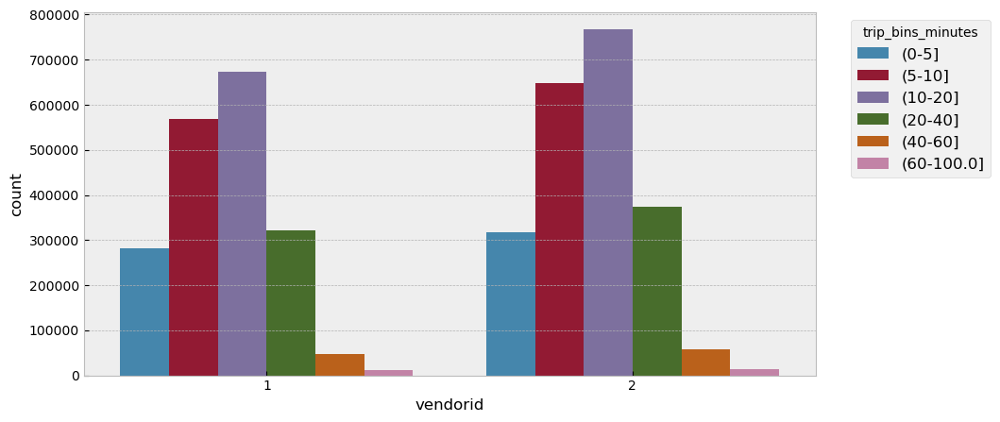

In [33]:
g = sns.countplot(x = 'vendorid', data = nyc_raw, hue = 'trip_bins_minutes', ) 
_ = plt.legend(bbox_to_anchor = (1.25, 1.0),  fontsize = 12, title = 'trip_bins_minutes')

* Vendor_id doesn't seem to have any difference on the trip_duration and logically it seems right because it's just the provider which provides the record, and doesn't necessarily have any physical influence on the trip duration of a trip, except any margin for data reporting errors. 

0.55% of the trips were such that their information was stored and then forwarded


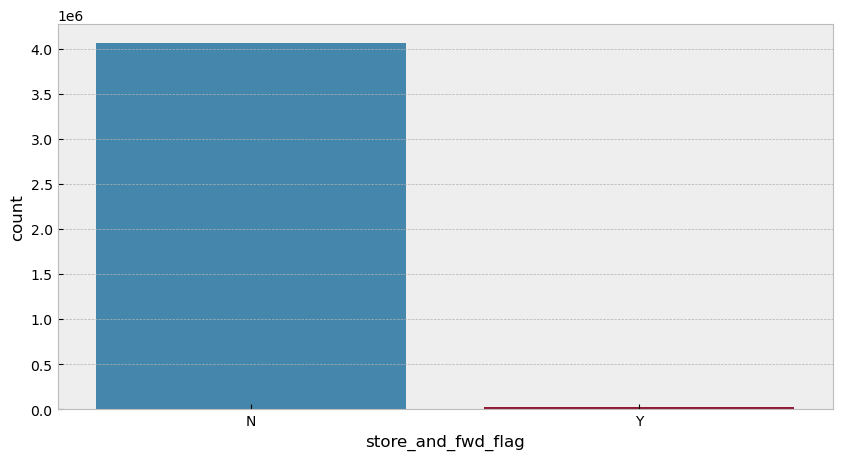

In [34]:
_ = sns.countplot(x = 'store_and_fwd_flag', data = nyc_raw)
print("{:.2f}% of the trips were such that their information was stored and then forwarded".format(
                                    100*len(nyc_raw[nyc_raw['store_and_fwd_flag'] == 'Y'])/len(nyc_raw)))

* store_and_fwd_flag has only 0.55% of the trips marked as Y and rest of the trips are marked as N. So, this variable shouldn't have any effect on the trip_duration as well.

#### Distribution of pickup and dropoff lat lons

* Most of the trips that were _0_ to _20_ minutes long lie between the 40.68 and 40.82 latitude range and the -74.02 to -73.94 longitude range, which mostly covers the Manhattan region. So, we can say that most of the trips with shorter trip durations were located within the Manhattan borough.

#### Distribution of  
1. y variable _trip_duration_ 
2. average trip speed in mph
3. the haversine distance

#### Distribution of trip duration 

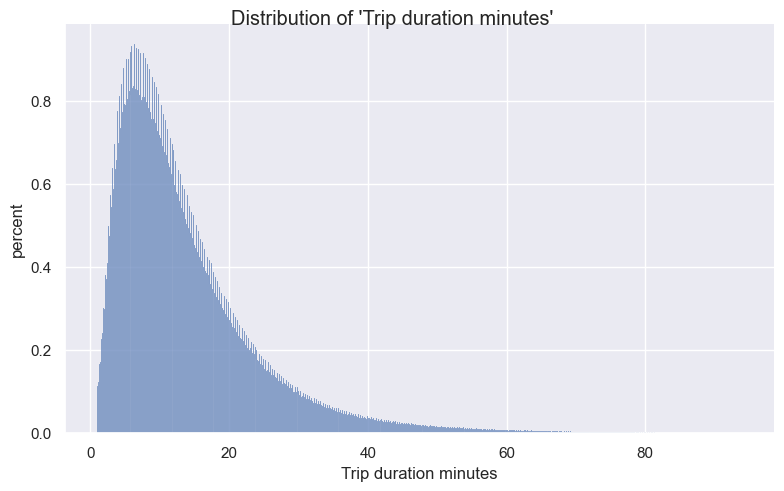

In [35]:
plot_figs.distribution(x_col = 'trip_duration_minutes', data = nyc_raw, figsize = (8,5), stat = 'percent')

#### Histogram of the speed variable 

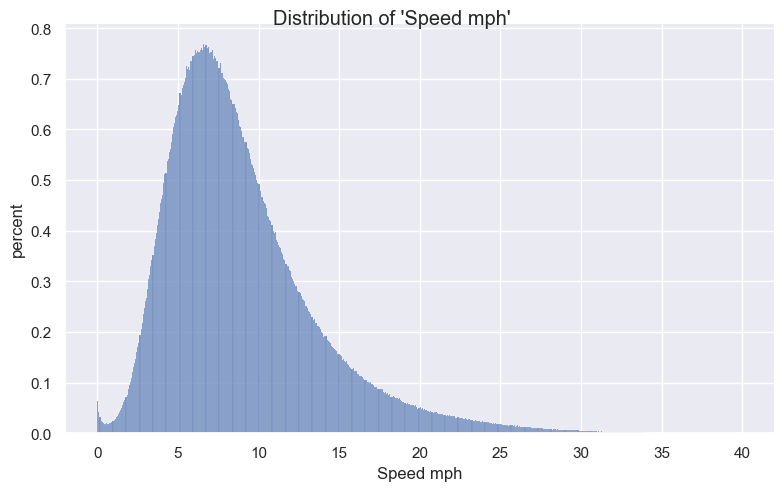

In [36]:
plot_figs.distribution(x_col = 'speed_mph', data = nyc_raw.loc[nyc_raw.speed_mph < 40], stat = 'percent', figsize = (8, 5))

#### Histogram of trip distance (estimated) categorized by the trip duration bins

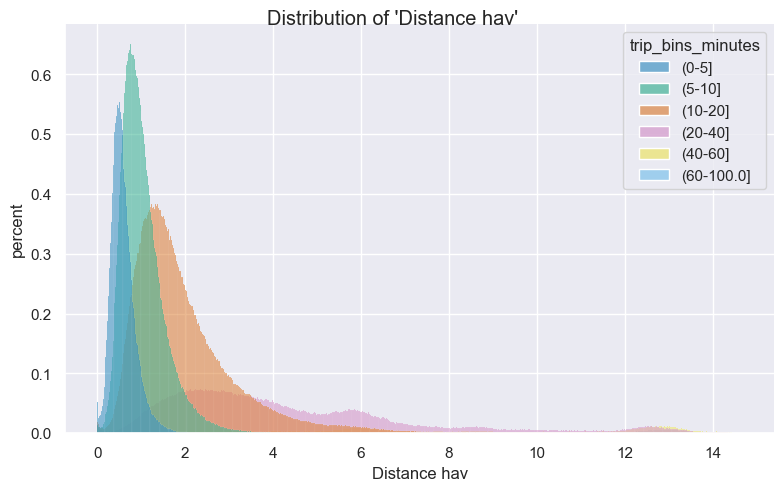

In [37]:
#_ = sns.histplot(hue = 'trip_bins_minutes', x = 'distance_hav', data = nyc_raw, palette = 'colorblind6')
plot_figs.distribution(x_col = 'distance_hav', data = nyc_raw[nyc_raw['distance_hav'] < np.percentile(nyc_raw['distance_hav'], 99.9)], 
                       hue = 'trip_bins_minutes', stat = 'percent', figsize = (8, 5), palette = 'colorblind6', facet_kws = dict(legend_out=False))

* The distribution of _distance_ is narrow and located between _0_ to _7_ miles for the shorter trips from _0_ to _20_ minutes as expected.
* As the _trip_duration_ bins go higher the _distance_ distributions shift to the right because _trip duration_ is directly proportional to the distance travelled.
* The _>20 and <60_ _trip duration_ bins have a wide spread of _distance_ values with multiple peaks, wheras the _60-100_ bin has the distance distribution between 10 to 15 miles indicating long trips. The two peaks in the 20-40 and 40-60 trip_duration bins can indicate that there are other factors that affect the trip duration but it also can mean that our estimated distance values are lower than the real values especially for the lower peaks.

#### Regression plot _trip_duration_ vs. the _haversine_distance_

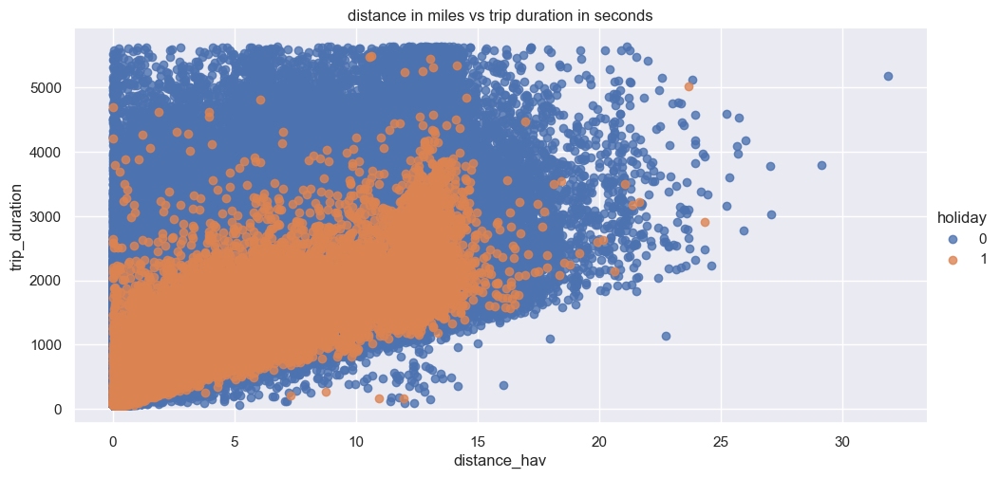

In [38]:
_ = sns.lmplot(x = 'distance_hav', y = 'trip_duration', 
                data = nyc_raw, ci = None, hue = 'holiday', fit_reg=False, 
                aspect = 2, height = 5)
_ = plt.title('distance in miles vs trip duration in seconds')

We can also see the correlations using the scipy.stats.pearsonr function. The scipy.stats.pearsonr function returns the pearsonr coefficient and the pvalue of observing such coefficient if we were to assume that there was no correlation between the x and y data sets. Let's select a signifance level of 5%, and so if the pvalue is <5%, we will assume that the correlation coefficienct returned is significant.

In [39]:
# Let's calculate the pearsonr coefficient between the energy and temperature
scipy.stats.pearsonr(nyc_raw['distance_hav'], nyc_raw['trip_duration'])

PearsonRResult(statistic=0.7739721777394433, pvalue=0.0)

* We can assume that the haversine distance, though not an exact ride distance, is a useful variable in predicting the trip duration and it also seems logical because keeping other factors more or less constant the trip duration of a trip is directly proportional to the distance travelled.
___

#### To better visualize the trips within each NYC Taxi zone and the 5 boroughs lets combine the taxi trips dataset with the NYC taxi zones shape files.

# 3. Adding NYC taxi zones data (shapefile) <a name="3"></a> [(toc)](#0) 

## 3.1 Mapping the pickup and dropoff lat lon locations onto the taxi zones <a name="3.1"></a> [(toc)](#0)

In [40]:
import pyproj
pyproj.__version__

'3.1.0'

#### The NYC shape files were downloaded from [here](https://www1.nyc.gov/site/tlc/about/tlc-trip-record-data.page).

In [41]:
# Setting the coordinate system and loading the taxi_zones.shp file into a geopandas dataframe

coord_system = pyproj.CRS('epsg:4326') 
nyc_shp = gpd.read_file('../data/external/taxi_zones_shape/taxi_zones.shp').to_crs(coord_system)
nyc_shp = nyc_shp.drop(['Shape_Area', 'Shape_Leng', 'OBJECTID'], axis=1)
nyc_shp.head() 

## REF: https://www.nceas.ucsb.edu/~frazier/RSpatialGuides/OverviewCoordinateReferenceSystems.pdf

,zone,LocationID,borough,geometry
0,Newark Airport,1,EWR,"POLYGON ((-74.18445 40.69500, -74.18449 40.695..."
1,Jamaica Bay,2,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ..."
2,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((-73.84793 40.87134, -73.84725 40.870..."
3,Alphabet City,4,Manhattan,"POLYGON ((-73.97177 40.72582, -73.97179 40.725..."
4,Arden Heights,5,Staten Island,"POLYGON ((-74.17422 40.56257, -74.17349 40.562..."


In [42]:
nyc_shp.LocationID.nunique(), (nyc_shp.LocationID.min(), nyc_shp.LocationID.max()), nyc_shp.borough.unique()

(260,
 (1, 263),
 array(['EWR', 'Queens', 'Bronx', 'Manhattan', 'Staten Island', 'Brooklyn'],
       dtype=object))

In [43]:
# converting the 'borough' object to label encoded numbers to show the distinct boroughs in the below zone map
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
nyc_shp['borough_num'] = le.fit_transform(nyc_shp.borough)
nyc_shp['borough_num'].unique()

array([2, 4, 0, 3, 5, 1])

In [44]:
# Plotting the zones on the geo map
plot_zone = plot_figs.zone_plot(nyc_shp, fill_color = 'borough_num')
show(plot_zone)

In [45]:
# let's find out which zone does a random point in the map belongs to
gpd.sjoin(gpd.GeoDataFrame(crs = coord_system, geometry = [Point(-73.985510, 40.750993)]), 
          nyc_shp, how='left', op='within')

,geometry,index_right,zone,LocationID,borough,borough_num
0,POINT (-73.98551 40.75099),163,Midtown South,164,Manhattan,3


#### Now, let's map all the points in our dataframe into the zone locations

In [46]:
import importlib
import taxi_zone_async
importlib.reload(taxi_zone_async)

<module 'taxi_zone_async' from '/Users/pratha/GithubRepos/NYC_taxi_trip/notebooks/../NYC/taxi_zone_async.py'>

In [47]:
from taxi_zone_async import AddShapeFileZones

nyc_zone_file_loc = '../data/interim/2_nyc_with_zones.parquet'
nyc = AddShapeFileZones(raw_df = nyc_raw).add_zone_info(nyc_zone_file_loc, fetch_if_exists = False)

# time to run function add_zone_info: 45.57362 seconds

 ../data/interim/2_nyc_with_zones.parquet file doesn't exist; we need to carry out the lat/lon to zone mapping ops
Mapping the pickup locations
{'lon_var': 'pickup_longitude', 'lat_var': 'pickup_latitude', 'locid_var': 'pickup_taxizone_id', 'taxi_zones_file': '../data/external/taxi_zones_shape/taxi_zones.shp'}
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 1
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 4
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 0
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 3
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 7
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 5
assigning taxi zones to each location: pickup_longitude, pickup_latitude, chunk = 2
Mapping the dropoff locations
{'lon_var': 'dropoff_longitude', 'lat_var': 'dropoff_latitude', 'locid

In [49]:
try: 
    assert len(nyc) == len(nyc_raw) 
    del nyc_raw #deleting previous dataframe to clear some space
except NameError as e: 
    print(f"{e.name} doesn't exist. If this cell was already run before, the variable may have already been deleted \n")

In [50]:
nyc['pickup_taxizone_id'].nunique(), nyc['dropoff_taxizone_id'].nunique() 
#(246, 258)

(245, 257)

In [51]:
nyc.pickup_taxizone_id.isna().sum(), nyc.dropoff_taxizone_id.isna().sum()

(1104, 6482)

In [52]:
print("% of trips with pickups or dropoffs outside NYC taxi zones are ", 
      100*(nyc.pickup_taxizone_id.isna().sum() + nyc.dropoff_taxizone_id.isna().sum())/len(nyc))
# % of trips with pickups or dropoffs outside NYC taxi zones are  0.18715556817180726

% of trips with pickups or dropoffs outside NYC taxi zones are  0.185633267360846


In [53]:
# let's label the zones of these trips as 0.0
nyc.pickup_taxizone_id.fillna(0.0, inplace = True)
nyc.dropoff_taxizone_id.fillna(0.0, inplace = True)

#### Let's plot the above pickups and dropoff which fall outside the NYC boroughs

* Ineresting that some of the trips originate and end in the waters. These are some of the outliers that didn't get filtered out earlier. 
* We see that all the trips that originated or ended outside the 5 boroughs and NWR airport area haven't been mapped into the zones. 
* Since they represent only 0.18% of the data and after closely looking at the above graphs most of those trips lie in the waters, we can safely remove them. 

In [54]:
(nyc.pickup_taxizone_id == 0.0).sum(), (nyc.dropoff_taxizone_id == 0.0).sum()

(1104, 6482)

In [55]:
nyc = nyc[(nyc.pickup_taxizone_id != 0.0) & (nyc.dropoff_taxizone_id != 0.0)]

In [56]:
(nyc.pickup_taxizone_id == 0.0).sum(), (nyc.dropoff_taxizone_id == 0.0).sum()

(0, 0)

In [57]:
nyc.isna().sum().sum()

0

In [58]:
nyc = nyc.astype({'pickup_taxizone_id': 'int32', 'dropoff_taxizone_id': 'int32'})

In [59]:
nyc.reset_index(drop = True, inplace = True)

## 3.2. More EDA with NYC zones <a name="3.2"></a> [(toc)](#0)


#### Plotting the total number of rides in each zone and also the mean trip duration for trips originating and ending in each zone respectively

In [60]:
pickup_count = plot_figs.plot_zone_trips_counts(nyc, nyc_shp, to_plot = 'count', col_to_plot = "pickup_taxizone_id", divide_by = 1)
dropoff_count = plot_figs.plot_zone_trips_counts(nyc, nyc_shp, to_plot = 'count', col_to_plot = "dropoff_taxizone_id", divide_by = 1)
dropoff_count.x_range = pickup_count.x_range
dropoff_count.y_range = pickup_count.y_range

grid_count = plot_figs.gridplot([[pickup_count, dropoff_count]]) # can pass in width = 500, height = 500
show(grid_count)

* Around 100,000 or more trips originate and end in the Midtown and Lower Manhattan areas and also the Queens' airports- JFK and La Guardia.
* The dropoffs in these areas except the airports are comparably of the same magnitude. The airports have almost half the number of dropoffs as pickups. 

In [61]:
pickup_duration = plot_figs.plot_zone_trips_counts(nyc, nyc_shp, to_plot = 'trip_duration_minutes', 
                                                   col_to_plot = "pickup_taxizone_id", divide_by = 1)
dropoff_duration = plot_figs.plot_zone_trips_counts(nyc, nyc_shp, to_plot = 'trip_duration_minutes', 
                                                    col_to_plot = "dropoff_taxizone_id", divide_by = 1)
dropoff_duration.x_range = pickup_duration.x_range
dropoff_duration.y_range = pickup_duration.y_range

grid_duration = plot_figs.gridplot([[pickup_duration, dropoff_duration]]) # can pass in width = 500, height = 500
show(grid_duration)

* The average trip duration for rides picked up at the JFK airport is ~40 mts. and it takes on an average around 43 mts. for people from within NYC to reach the JFK airport. The same values for the La Guardia airport are 28 and 30 mts respectively.


#### Adding borough information

In [62]:
assert nyc.isna().sum().sum() == 0 , "the mapping of the nyc dataframe with the shape file created some null borough values,\
                                      check if the index of the nyc DF was reset to be a continuous range before mapping. "

In [63]:
print('pickup boroughs: ', sorted(nyc.pickup_borough.unique()), '\n', 
      'dropoff boroughs: ', sorted(nyc.dropoff_borough.unique()))

pickup boroughs:  ['Bronx', 'Brooklyn', 'EWR', 'Manhattan', 'Queens', 'Staten Island'] 
 dropoff boroughs:  ['Bronx', 'Brooklyn', 'EWR', 'Manhattan', 'Queens', 'Staten Island']


* If you zoom in, it can be seen that both pickups and dropoffs have dense clusters around the subway stations and also in the busy areas of NYC such as Garment district, Midtown south, Penn station and Times square. Majority of those trips are short trips indicating travel between offices and subway stations or travel to nearby zones or boroughs. 

___
#### Plotting the pickup and dropoff points side by side for trips that either started or ended at the JFK airport (zone id = 132). You can select any weekday value on the checkbox or slide across the hours to realize the flow of traffic to and from the airport. 

So, the left plot shows all the pickup points for trips that ended at JFK airport and similarly the right plot shows all the dropoff points for trips that started at the JFK airport.

In [64]:
nyc_shp

,zone,LocationID,borough,geometry,borough_num
0,Newark Airport,1,EWR,"POLYGON ((-74.18445 40.69500, -74.18449 40.695...",2
1,Jamaica Bay,2,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ...",4
2,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((-73.84793 40.87134, -73.84725 40.870...",0
3,Alphabet City,4,Manhattan,"POLYGON ((-73.97177 40.72582, -73.97179 40.725...",3
4,Arden Heights,5,Staten Island,"POLYGON ((-74.17422 40.56257, -74.17349 40.562...",5
...,...,...,...,...,...
258,Woodlawn/Wakefield,259,Bronx,"POLYGON ((-73.85107 40.91037, -73.85207 40.909...",0
259,Woodside,260,Queens,"POLYGON ((-73.90175 40.76077, -73.90147 40.759...",4
260,World Trade Center,261,Manhattan,"POLYGON ((-74.01333 40.70503, -74.01327 40.704...",3
261,Yorkville East,262,Manhattan,"MULTIPOLYGON (((-73.94383 40.78286, -73.94376 ...",3


In [65]:
# If you're running this on your local macine make sure you just pass a small sample of the dataset to avoid slowdown
ZONE_ID_LIST = [132]
BOROUGH_ID = 'Manhattan'

df_to_plot = nyc[nyc.pickup_taxizone_id.isin(ZONE_ID_LIST)] #nyc[(nyc.pickup_borough== BOROUGH_ID) | (nyc.dropoff_borough == BOROUGH_ID)].sample(frac = 0.1) 

### the below cells will run only if have entered the API key in an apikey.txt file in this repo

# intrc_trips_loc_p = plot_figs.plot_gmaps(df_to_plot, slider = True, 
#                latitude_column= ['pickup_latitude', 'dropoff_latitude'], 
#                longitude_column = ['pickup_longitude', 'dropoff_longitude'],
#                color_column = 'trip_duration_minutes', size_column = 5.0,
#                api_key = api_key, map_type = 'roadmap', map_zoom = 10)
# 
# show(intrc_trips_loc_p)
# 
#_ = save([intrc_trips_loc_p, op_2 ], filename = "../data/interim/images/interactive_JFK_trips.html")
#IFrame("../data/interim/images/interactive_JFK_trips.html", width = 500, height = 500) 

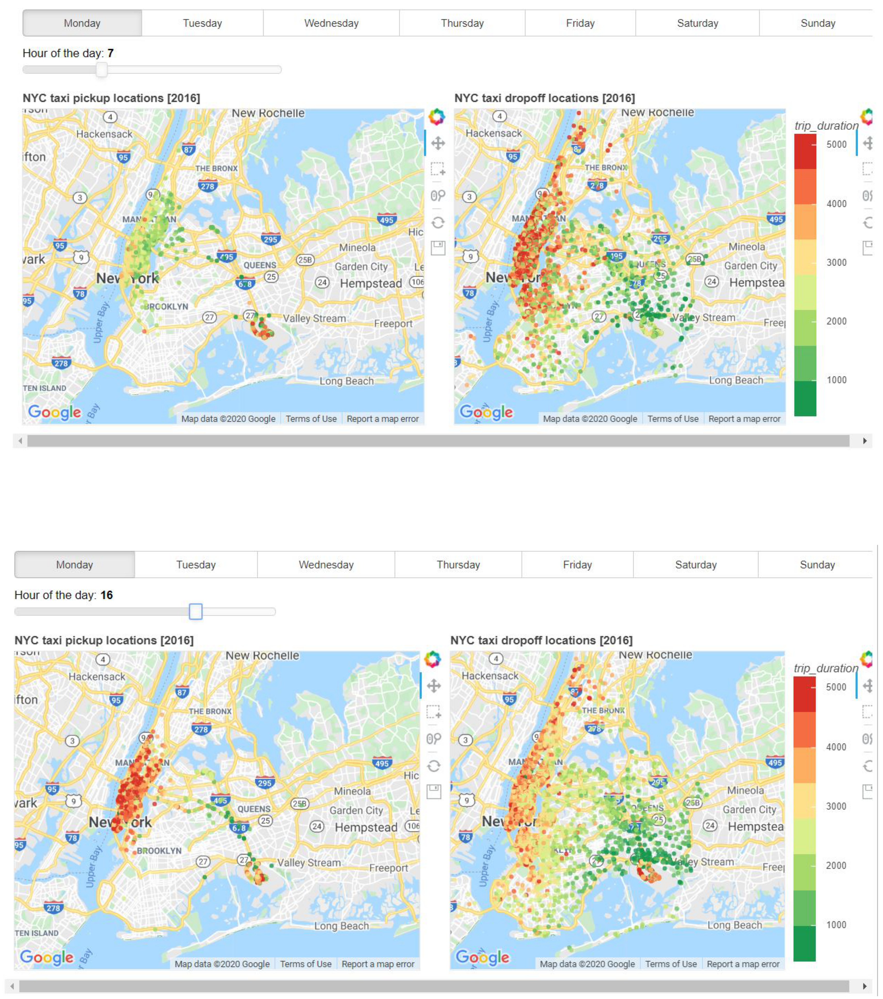

In [66]:
JFK_pick_drop_7am = plt.imread('../data/interim/images/NYC_interactive_JFK_pickups_dropoffs_7am.jpg')
JFK_pick_drop_4pm = plt.imread('../data/interim/images/NYC_interactive_JFK_pickups_dropoffs_4pm.jpg')
fig, ax = plt.subplots(2, 1, sharex = True, figsize=(50, 50))
for i, j in enumerate([JFK_pick_drop_7am, JFK_pick_drop_4pm]):
    ax[i].imshow(j)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].grid(False)

* The travel time from the airport into the city (Manhattan, Queens, Brooklyn) and from the city to the airport ranges from 20 to 40 minutes from the midnight to early morning.
* The same time between the city and the airport increases significantly towards the higher range of 40 to 80 minutes during the day, peaking during the evening hours. 
* One important observation is that, in the morning hours (6 am onwards) the traffic from the airport towards Manhattan is pretty slow compared to the traffic from Manhattan to the airport. And between 2 pm to 6 pm the traffic keeps getting slower in the Manhattan to Airport direction and in this time range it is slower than the opposite traffic. This can be attributed to the fact that many people travel for work to NYC from outer boroughs in the morning increasing the traffic in that direction whereas many taxis head out of Manhattan to outer boroughs in the direction of the airport in the evening time making the traffic slower in that direction.

* NOTE:  
* `You can also select a single or multiple pickup or dropoff points using the box-select tool and the plot will highlight the corresponding dropoff or pickup points in the adjacent map respectively.`
* NOTE: `If instead of running a copy of this notebook, you are just viewing it on Github or nbviewer the above plot with callback functions associated with it won't be visible. So, please find below the same plots in static mode for 7am and 4pm on a Monday.`

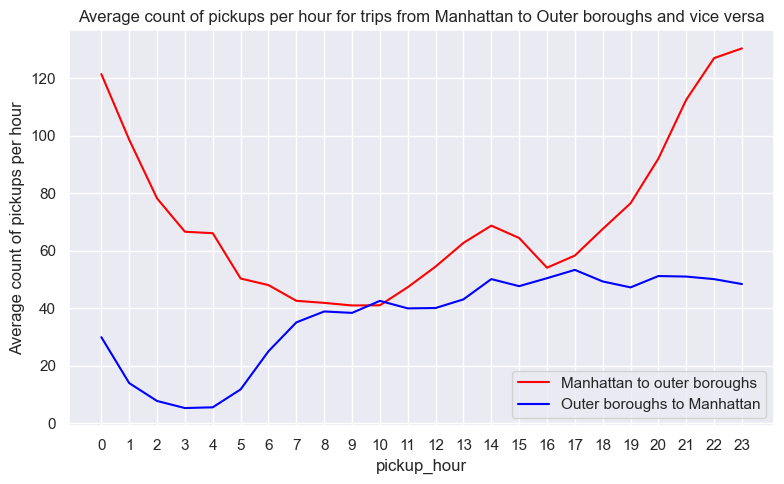

In [67]:
# Plotting the average number of rides per hour
ax = plt.subplot(111)
_ = nyc[(nyc.pickup_borough == "Manhattan") & (nyc.dropoff_borough != "Manhattan")].groupby(['pickup_date', 
                    'pickup_hour']).count()['vendorid'].groupby('pickup_hour').mean().plot(ax = ax, color = 'red')
_ = nyc[(nyc.pickup_borough != "Manhattan") & (nyc.dropoff_borough == "Manhattan")].groupby(['pickup_date', 
                    'pickup_hour']).count()['vendorid'].groupby('pickup_hour').mean().plot(ax = ax, color = 'blue')

_ = plt.legend(['Manhattan to outer boroughs', 'Outer boroughs to Manhattan'])
_ = plt.ylabel('Average count of pickups per hour')
_ = plt.xticks(nyc.pickup_hour.unique())
_ = plt.title('Average count of pickups per hour for trips from Manhattan to Outer boroughs and vice versa')
_ = plt.tight_layout()

The traffic from outer boroughs to Manhattan increases during the morning time and stays more or less the same until 11pm. On the other hand the traffic from Manhattan to outer boroughs increases from 5 pm to late in the night.

In [68]:
nyc.columns

Index(['vendorid', 'pickup_datetime', 'dropoff_datetime', 'passenger_count',
       'pickup_longitude', 'pickup_latitude', 'store_and_fwd_flag',
       'dropoff_longitude', 'dropoff_latitude', 'trip_duration', 'pickup_date',
       'pickup_month', 'pickup_day', 'pickup_hour', 'pickup_weekday',
       'holiday', 'distance_hav', 'bearing', 'speed_mph',
       'trip_duration_minutes', 'trip_bins_minutes', 'pickup_taxizone_id',
       'dropoff_taxizone_id', 'pickup_borough', 'dropoff_borough',
       'pickup_zone_name', 'dropoff_zone_name'],
      dtype='object')

#### Removing the _very slow_ and _very fast_ outliers from the data

In [69]:
nyc = nyc[(nyc.speed_mph > 0.5) & (nyc.speed_mph <= 80)]

In [70]:
nyc.reset_index(inplace = True, drop = True)

In [71]:
count_nyc_col = len(nyc.columns)

# 4. EDA on trip direction <a name="4"></a> [(toc)](#0)

It was observed, especially for the airport trips, that the direction of the trip also has some effect on the trip duration. 
And there are many one-way streets in Manhattan forming a grid structure as seen in the maps. So, for example, someone at Penn station going north towards Central park will try to hail a cab from the road catering traffic flowing to north.   

Let's add the bearing of each trip which simply means the overall direction in which the taxi travelled from the pickup point to the dropoff point.  
The convention followed here is such the _North_ is denoted as 0 degrees, _East_ as 90 degrees, _South_ as 180 degrees, _West as 270 degrees and _circle back to North_ as 360 degrees.

#### Trip directions for all boroughs 

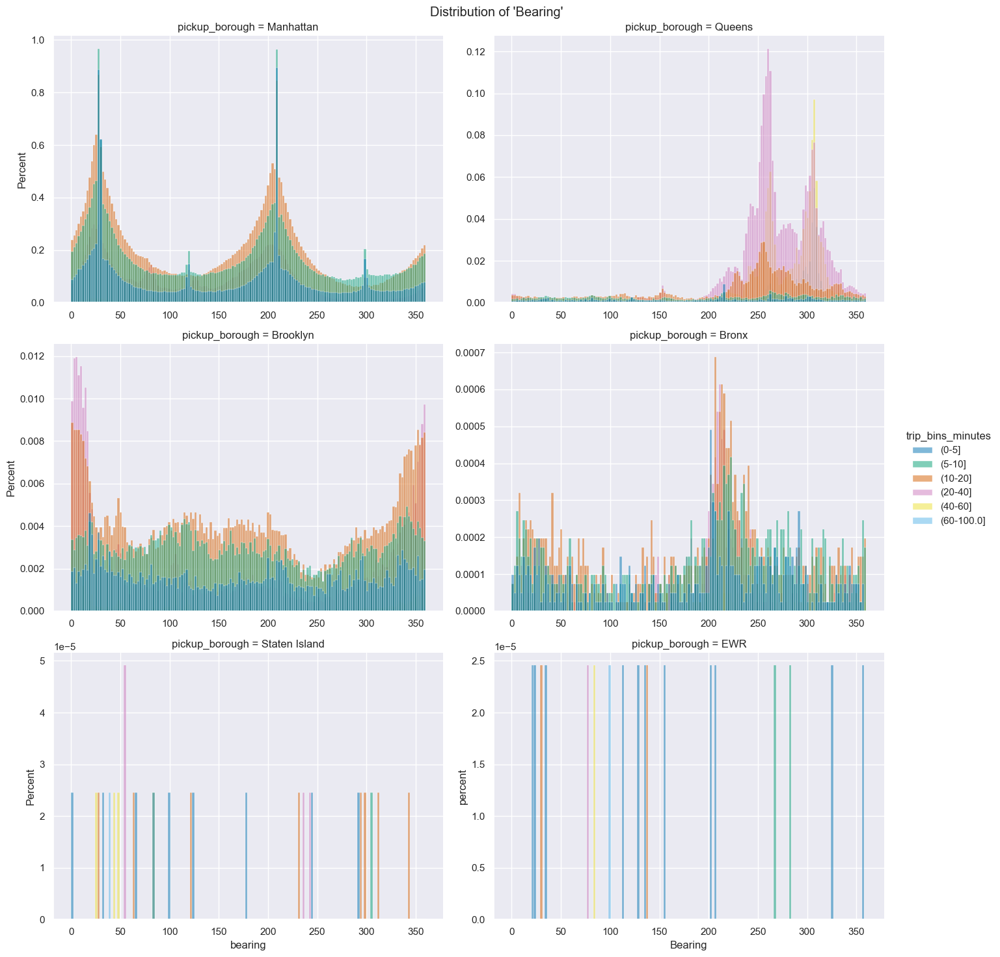

In [72]:
plot_figs.distribution(x_col = 'bearing', data = nyc, stat = 'percent', figsize = (7, 5),
                       hue = 'trip_bins_minutes', col = 'pickup_borough',
                       palette = 'colorblind6', col_wrap = 2, facet_kws = {'sharex': False, 'sharey': False})

* Most of the trips from Queens are directed towards West and North-West. This kind of makes sense because La Guardia airport lies in the NorthWest (of Queens) and also if a taxi has to travel from Queens to Manhattan it has to travel in West direction.
* Trips from Brooklyn seem to be spread out uniformly across all directions but most common direction is North (0 Deg and 360 Deg) which indicates travel to Manhattan.
* Trips from Bronx are also directed mostly in the South-West direction indicating travel to Manhattan.

In [73]:
cut_speed_labels = ['(0-5]', '(5-10]', '(10-20]', '(20-40]', 
                    '(40-'+str(np.ceil((nyc['speed_mph']).max()/10)*10)+']']
cut_bins_speed = [0, 5, 10, 20, 40, np.ceil((nyc['speed_mph']).max()/10)*10]
nyc['trip_bins_speed'] = pd.cut((nyc['speed_mph']), bins = cut_bins_speed, labels = cut_speed_labels)

#### Trip direction of all boroughs categorized by speed_mph

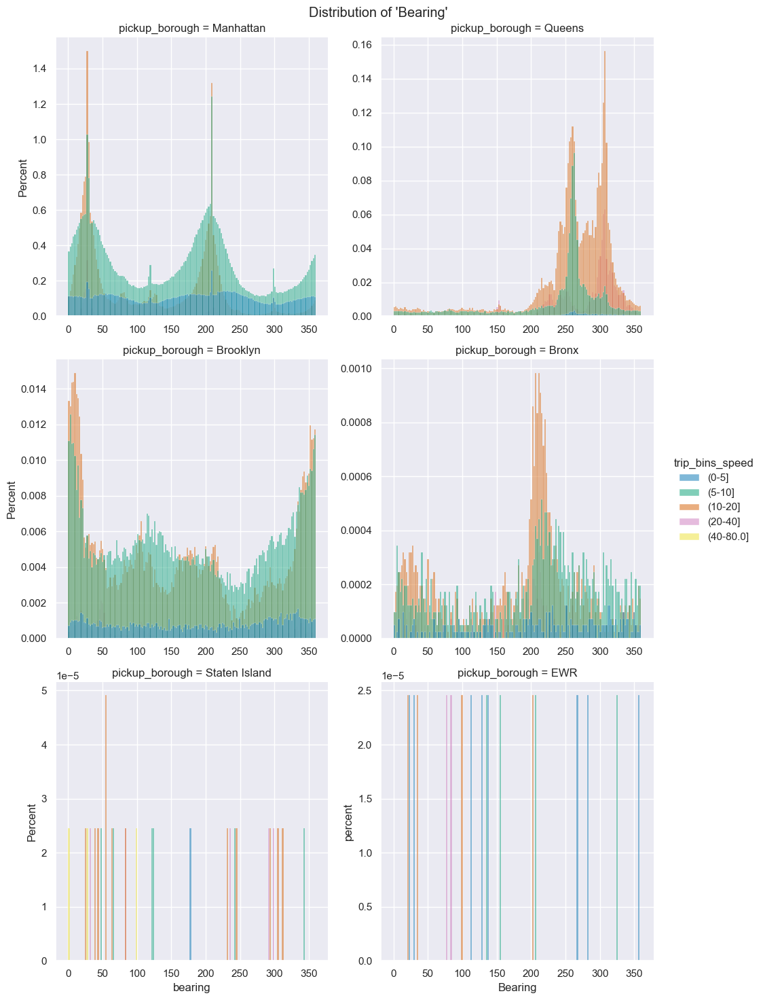

In [74]:
plot_figs.distribution(x_col = 'bearing', data = nyc, stat = 'percent', figsize = (5, 5),
                       hue = 'trip_bins_speed', col = 'pickup_borough',
                       palette = 'colorblind6', col_wrap = 2, facet_kws = {'sharex': False, 'sharey': False})


* We can see distinct peaks in the North-East and South-East direction which wasn't very dominant in the graph for other boroughs except Manhattan. So, these trips represent mostly the trips originating from Manhattan and the direction of travel makes sense given the stretch of Manhattan in the North-East to South-West direction. 
* The slower trips (0-5 mph) are spread uniformly across all directions indicating short distance travel within the boroughs. Whereas the faster trips (5-10 mph and 10-20 mph) seem to spread in the North-East and South-West direction which can be travel within Manhattan and also travel from other boroughs to Manhattan. 
* We can see other peaks for the faster trips (20-40 mph) in the South-East and North-West direction which can be the travel to and fro Manhattan to JFK airport. 

# 5. Clustering the similar zones <a name="5"></a> [(toc)](#0)

* We have the NYC map divided into taxi zones, but the location id of these zones don't follow any pattern and also there are a total of 263 zones, so, to make the locations more useful and reduce the total number of clusters, we will re-cluster the zones into larger clusters.
* The attributes that will be used to do the clustering are the centroid latitude and longitude of each zone and the traffic density in each zone at each hour. Traffic density is defined as the number of dropoffs in a zone at each hour minus the number of pickups in that zone for the corresponding hour, kind of indicating how busy the zones are at any particular hour.

#### Before clustering the data we need to normalize the variables

* We will use the Agglomerative Hierarchical Clustering method here for the sake of simplicity and interpretability. 

* More details on the hierarchical clustering can be found [here](https://www.analyticsvidhya.com/blog/2019/05/beginners-guide-hierarchical-clustering/).

* There are many methods that can be used to form the clusters including the single linkage, complete linkage, average linkage, centroids, ward’s method, etc. Ward’s or minimal increase of sum-of-squares method was used here for the clustering. Basically, when joining two clusters this method evaluates how does the joining of two clusters affect the sum of squared distances of the individual points/clusters from the centroids. 
* Keep in mind that hierarchical clustering is a very space and time-consuming method to train a large dataset but here we already have taxi zones defined and we are going to cluster only the taxi zones together. We can then use the taxi zone clusters to cluster the individual pickup and dropoff locations. So, we will only be clustering 263 rows here, which doesn’t take more than a few seconds.


In [75]:
from data_fetch_n_save import AddClusterLabels

In [77]:
cluster_obj = AddClusterLabels(nyc)

nyc = cluster_obj.add_cluster_labels(nyc_cluster_file_loc = '../data/interim/3_nyc_cluster.parquet', fetch_if_exists = False,
                                     taxi_zones_file = '../data/external/taxi_zones_shape/taxi_zones.shp')
#time to run function add_cluster_labels: 5.07823 seconds

Reading the nyc zone shape file
Adding centroid lat and lon for each zone's geometry


/Users/pratha/GithubRepos/NYC_taxi_trip/notebooks/../NYC/data_fetch_n_save.py:262: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroidseries = shape_df['geometry'].to_crs('epsg:4326').centroid.to_crs(shape_df.crs)


Adding the difference in outgoing and incoming trips per hour each zone
Adding whether a particular zone is an airport or not
Normalizing the values before clustering
Doing the clustering
Unique cluster labels generated: 50
Adding cluster labels back to the original df
Null values in the df: True
Saving the downloaded file to ../data/interim/3_nyc_cluster.parquet
time to run function add_cluster_labels: 10.99437 seconds


#### Drawing the dendrogram

The X-axis represents the rows of the dataframe that are clustered together and Y-axis displays the proximity; the higher you go along the Y-axis the proximity gets weaker. 

We can either choose a threshold (y-axis in the above graph) such that the clusters as visible above upto that threshold will be considered. For example, if you use a threshold of 0.25, the number of clusters comes to around 50. We can also directly feed in the number of clusters we want from the clustering model. After some back and forth with the scatter plot I have chosen 50 here. It divides the city and outskirt areas along with the airports pretty well.

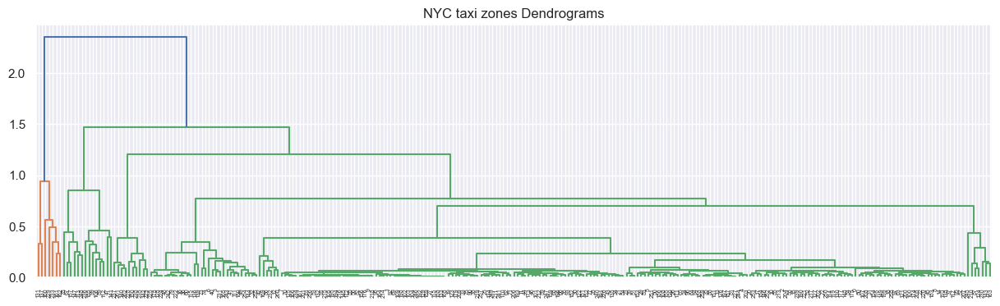

In [78]:
_ = cluster_obj.draw_dendogram() # run only when add cluster labels is run with `fetch_if_exists = True`

In [79]:
# Taking a look at the final dataframe
nyc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4070084 entries, 0 to 4070083
Data columns (total 29 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   vendorid               int64         
 1   pickup_datetime        datetime64[ns]
 2   dropoff_datetime       datetime64[ns]
 3   passenger_count        int64         
 4   pickup_longitude       float64       
 5   pickup_latitude        float64       
 6   store_and_fwd_flag     object        
 7   dropoff_longitude      float64       
 8   dropoff_latitude       float64       
 9   trip_duration          float64       
 10  pickup_date            datetime64[ns]
 11  pickup_month           int64         
 12  pickup_day             int64         
 13  pickup_hour            int64         
 14  pickup_weekday         category      
 15  holiday                int64         
 16  distance_hav           float64       
 17  bearing                float64       
 18  speed_mph             

# 6. Future Work <a name="6"></a> [(toc)](#0)

Potential additions to the EDA and general visualizations:
* Subway stations and other important information about potential busy areas can be added into the data and traffic trend around these areas of interest can be verified. 
* A network graph to check how the zones are connected to each other based on the pickups and dropoffs.
    - Betweenness centrality can be added for each node in the graph.
    - Shortest path for any ride can be found and the nodes/edges through which the taxi has to pass to reach the destination  
       can be determined. Then an average speed score can be assigned to that path based on the speed score of each edge the          taxi is traversing through. This can be used as a new feature.
* Add weather data to check the effect of snow, precipitation and rain on the trip duration. 
* Start with a simple model to predict the trip_duration and build upon it by adding more features and using more complex models.